# Music Loader

In [17]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [18]:
import numpy as np
import music21 as m21
import pickle

from utils import *

import IPython.display as ipd

In [ ]:
def parse_part(part):
    line = [] # (midi key, quarterLength)

    for event in part.flatten():
        if isinstance(event, m21.note.Note):
            line.append((event.pitch.midi, event.duration.quarterLength))
        elif isinstance(event, m21.note.Rest):
            line.append((0, event.duration.quarterLength))
        elif isinstance(event, m21.chord.Chord):
            line.append((0, event.duration.quarterLength))

    return line

## Bach

Let's load the corpus from music21.

In [19]:
corpus = m21.corpus.search("bach")

Let's look at the format for a single piece.

In [33]:
meta = corpus[0]

score = meta.parse()
stream = score.parts.stream()

parts = score.parts
print(f"parts: {[part.partName for part in parts]}")

# use the first part (instrument)
part = parts[0]

print(f"{part.partName} has {len(part.flatten().notes)} notes")

parts: [None]
None has 107 notes


In [35]:
for event in part.flatten()[:20]:
    if isinstance(event, m21.note.Note):
        print("Note: {} {} {}".format(event.pitch.name, event.pitch.octave, event.duration.quarterLength))
    elif isinstance(event, m21.chord.Chord):
        print("Chord: {} {}".format(event.pitches, event.duration.quarterLength))
    elif isinstance(event, m21.note.Rest):
        print("Rest: {}".format(event.duration.quarterLength))
    else:
        print("Unknown: {}".format(event))

Unknown: <music21.clef.TrebleClef>
Unknown: <music21.tempo.MetronomeMark andante Half=72>
Unknown: C major
Unknown: <music21.meter.TimeSignature 4/4>
Note: C 5 1.0
Note: G 5 1.0
Note: G 5 0.75
Note: G 5 0.25
Note: G 5 1.0
Note: A 5 1/3
Note: G 5 1/3
Note: F 5 1/3
Note: E 5 1.0
Note: E 5 0.75
Note: E 5 0.25
Note: E 5 1.0
Note: C 5 1/3
Note: D 5 1/3
Note: E 5 1/3
Note: D 5 1.0


Let's look at the number of parts per piece in the corpus. This will help us decide how to handle multi-part pieces.

In [40]:
scores = [meta.parse() for meta in corpus]

In [41]:
n_parts = [len(score.parts) for score in scores]

Text(0.5, 1.0, 'Histogram of melody lengths (n=564)')

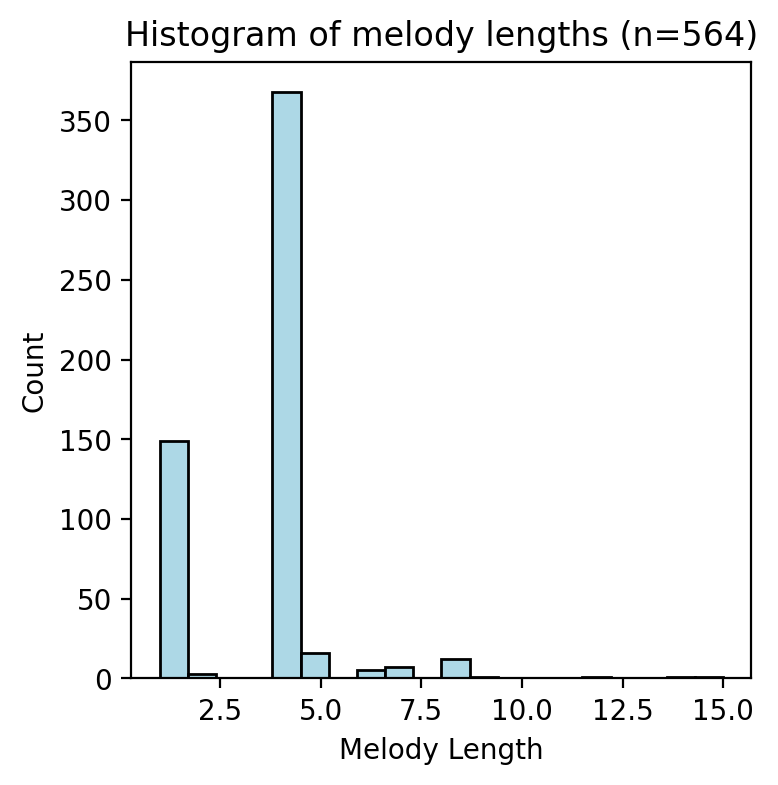

In [42]:
fig, ax = plt.subplots(figsize=(4,4))
ax.hist(n_parts, bins=20, color="lightblue", edgecolor="black")
ax.set_xlabel("Melody Length")
ax.set_ylabel("Count")
ax.set_title(f"Histogram of melody lengths (n={len(n_parts)})") 

In [49]:
bach_scores = []

filter_scores = [score for score in scores if len(score.parts) == 4]
print(f"Filtered {len(scores)} scores to {len(filter_scores)} scores")

print("Parsing scores...")
for i, score in enumerate(filter_scores):
    if i % 50 == 0:
        print(f"{i}/{len(filter_scores)}")

    parts = score.parts

    bach_score = [parse_part(part) for part in parts]
    bach_scores.append(bach_score)

print("Done!")

Filtered 564 scores to 368 scores
Parsing scores...
0/368
50/368
100/368
150/368
200/368
250/368
300/368
350/368
Done!


Let's save the parsed scores to a file so we don't have to parse them again.

In [29]:
with open("data/bach.pkl", "wb") as f:
    pickle.dump(bach_scores, f)

Let's listen to the first score:

In [30]:
x = bach_scores[0]

In [31]:
write_wav(x, "out/bach.wav")

In [32]:
ipd.Audio("out/bach.wav")

## Palestrina

In [10]:
paths = m21.corpus.getComposer("palestrina")

In [11]:
path = paths[0]

score = m21.corpus.parse(path)

In [12]:
parts = score.parts
print(f"parts: {[part.partName for part in parts]}")

# use the first part (instrument)
part = parts[0]

print(f"{part.partName} has {len(part.flatten().notes)} notes")

parts: ['Soprano', 'Alto', 'Tenor', 'Tenor', 'Bass']
Soprano has 108 notes


In [13]:
x = [parse_part(part) for part in parts]

In [14]:
write_wav(x, "out/palestrina.wav")

In [15]:
ipd.Audio("out/palestrina.wav")